In [14]:
#Import Libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import metrics

%matplotlib inline

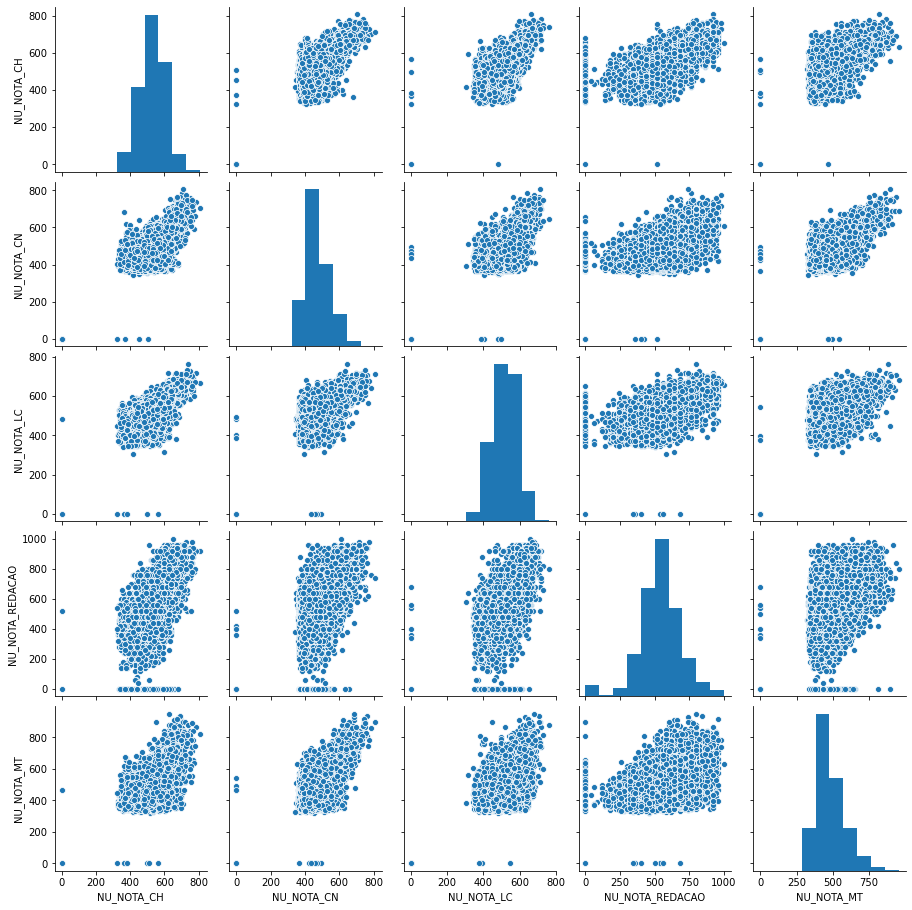

In [9]:
df_test = pd.read_csv('test.csv', sep = ',')
df_train = pd.read_csv('train.csv', sep = ',')

In [42]:
# Separate grade data
X_input = df_train[['NU_NOTA_CH', 'NU_NOTA_CN', 'NU_NOTA_LC', 'NU_NOTA_REDACAO']]
X_input.fillna(value = 0, inplace = True)

Y_input = df_train['NU_NOTA_MT']
Y_input.fillna(value = 0, inplace = True)

x_train, x_test, y_train, y_test = train_test_split(X_input, Y_input, test_size = 0.1)


Coefs
NU_NOTA_CH      -0.124711
NU_NOTA_CN       0.345162
NU_NOTA_LC       0.662602
NU_NOTA_REDACAO  0.083552
Erro absoluto médio: 50.34629160611902


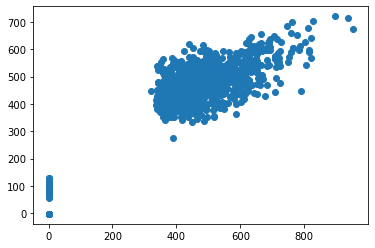

In [43]:
lm = LinearRegression()

lm.fit(x_train, y_train)
coefs = pd.DataFrame(lm.coef_, x_train.columns, columns = ['Coefs'])
print(coefs)

predict = lm.predict(x_test)
plt.scatter(y_test, predict)

print('Erro absoluto médio: {}'.format(metrics.mean_absolute_error(y_test, predict)))

In [44]:
registrationNumber = df_test['NU_INSCRICAO']
data_for_predict = df_test[['NU_NOTA_CH', 'NU_NOTA_CN', 'NU_NOTA_LC', 'NU_NOTA_REDACAO']]
data_for_predict.fillna(value = 0, inplace = True)

math_grade = lm.predict(data_for_predict)

#Create result
result = pd.DataFrame(math_grade, columns = ['NU_NOTA_MT'], index= registrationNumber)

#Replace negative values by zero
result[result['NU_NOTA_MT'] < 0] = 0
#Round decimal point
result = result.round(1)

#Export to a csv file
result.to_csv(r'answer.csv', index = True, header = True)

result.head()

,NU_NOTA_MT
NU_INSCRICAO,
73ff9fcc02f0a99919906c942c2e1a1042cdcf98,423.6
71a95f9f1b91a82c65ad94abbdf9f54e6066f968,482.6
b38a03232f43b11c9d0788abaf060f7366053b6d,558.6
70b682d9a3636be23f6120fa9d6b164eb3c6002d,0.0
715494628a50142ce8cb17191cfe6d0f3cae0934,545.8
